In [1]:
import cv2
import numpy as np
import os
from tqdm import tqdm
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from skimage import io

In [2]:
def visualize_segmentation_steps_hsv(image_path, save_path):
    image = io.imread(image_path)  
    
    # Convert to HSV COLOR SPACE
    hsv_image = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
    
    # Use the V channel (Value or brightness)
    V_channel = hsv_image[:, :, 2]  
    
    # Apply Gaussian Blur to reduce noise
    blurred = cv2.GaussianBlur(V_channel, (5, 5), 0)
    
    # Apply thresholding to the blurred image
    _, thresholded = cv2.threshold(blurred, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)
    
    # Detect contours from the thresholded image
    contours, _ = cv2.findContours(thresholded, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    # Find the largest contour (the mole)
    largest_contour = max(contours, key=cv2.contourArea)
    
    # Create a mask for the largest contour
    mask = np.zeros_like(V_channel)
    cv2.drawContours(mask, [largest_contour], -1, (255), thickness=cv2.FILLED)
    
    # Use the mask to isolate the mole
    mole_segmented = cv2.bitwise_and(image, image, mask=mask)
    mole_segmented_bgr = cv2.cvtColor(mole_segmented, cv2.COLOR_RGB2BGR)

    # Resize and save the segmented mole image
    x, y, w, h = cv2.boundingRect(largest_contour)
    cropped_mole = mole_segmented_bgr[y:y+h, x:x+w]
    mole_segmented_resized = cv2.resize(cropped_mole, (300, 300))
    
    cv2.imwrite(save_path, mole_segmented_resized)

    # Visualizing each step
    titles = ['Original Image', 'V Channel (Brightness)', 'Blurred', 'Thresholded', 'Mask', 'Segmented Mole']
    images = [image, V_channel, blurred, thresholded, mask, mole_segmented]

    plt.figure(figsize=(15, 10))

    for i, img in enumerate(images):
        plt.subplot(2, 3, i + 1)
        if img.ndim == 2:  
            plt.imshow(img, cmap='gray')
        else:
            plt.imshow(img)  
        plt.title(titles[i])
        plt.axis('off')

    plt.tight_layout()
    plt.show()

In [3]:
benign_folder = r"C:\Users\Mia\Desktop\kpgm\Benign"
malignant_folder = r"C:\Users\Mia\Desktop\kpgm\Malignant"

save_benign_folder = r"C:\Users\Mia\Desktop\kpgm\Benign\HSV"
save_malignant_folder = r"C:\Users\Mia\Desktop\kpgm\Malignant\HSV"


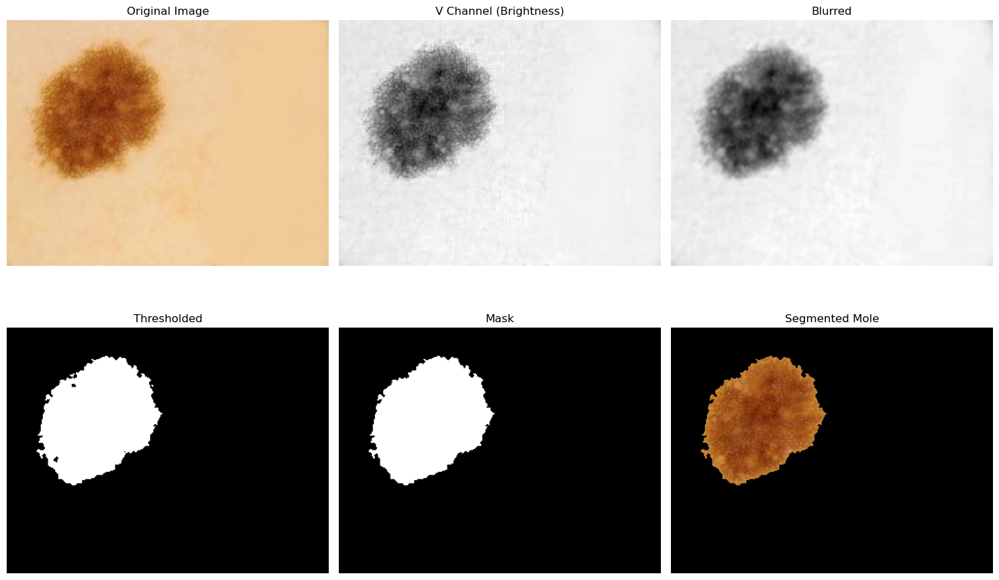

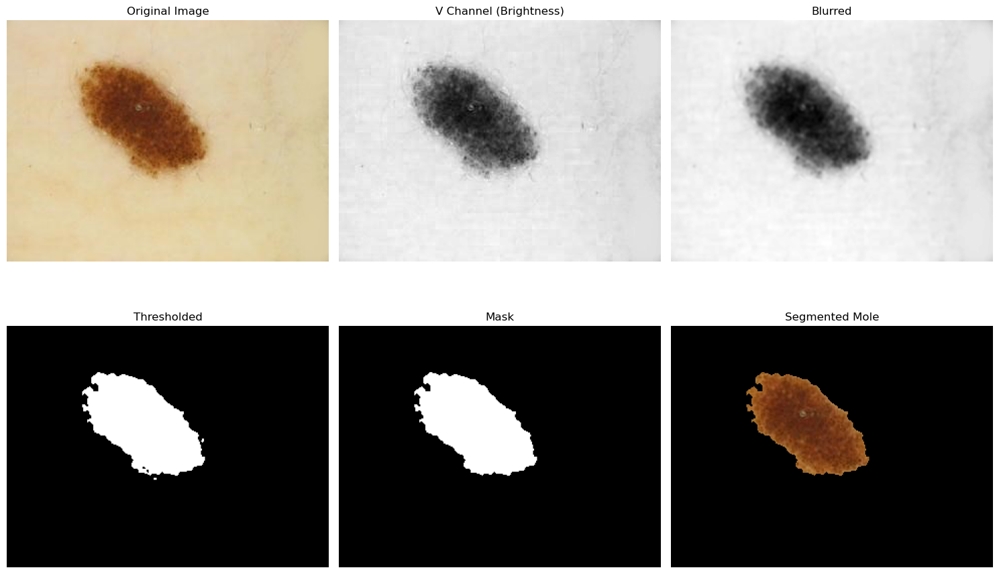

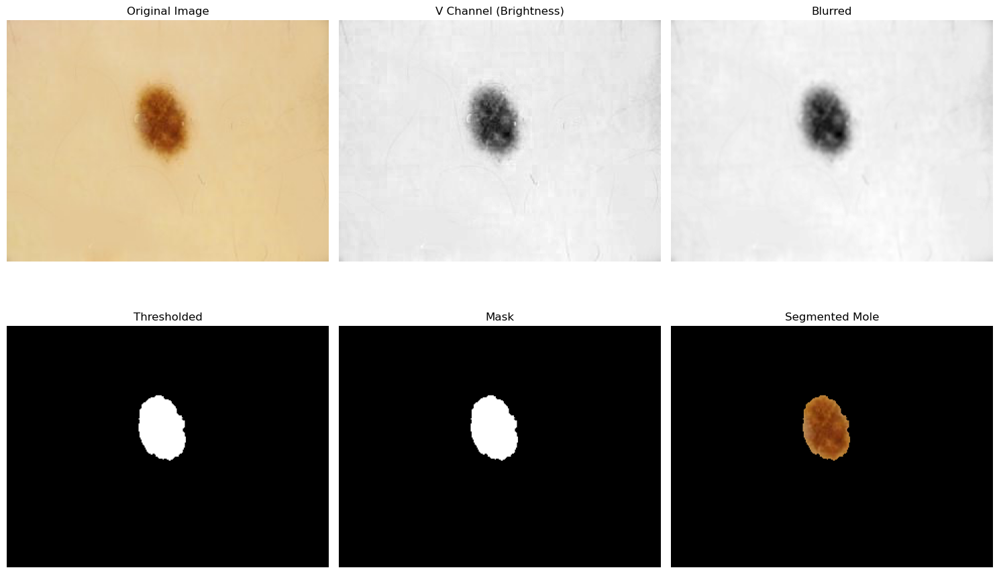

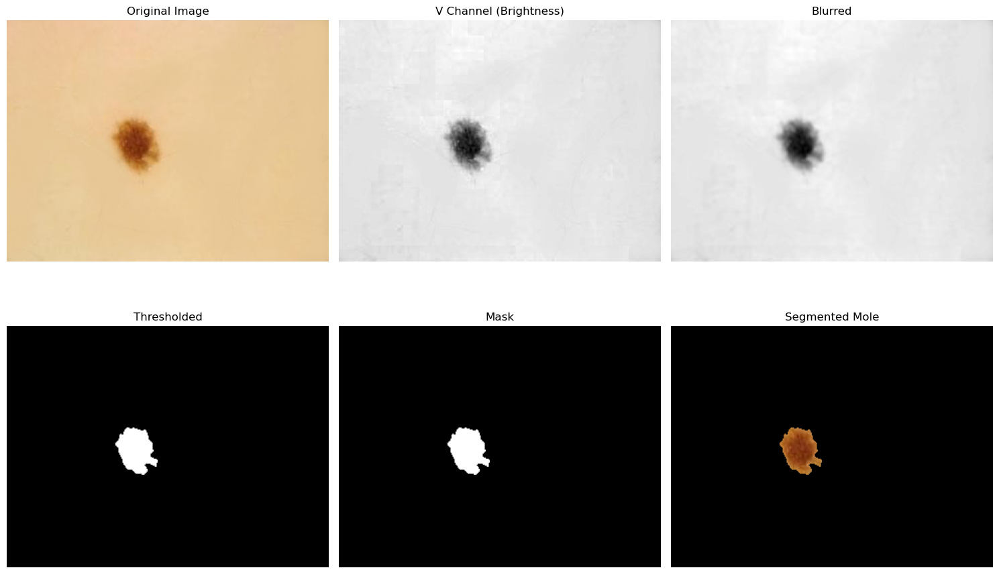

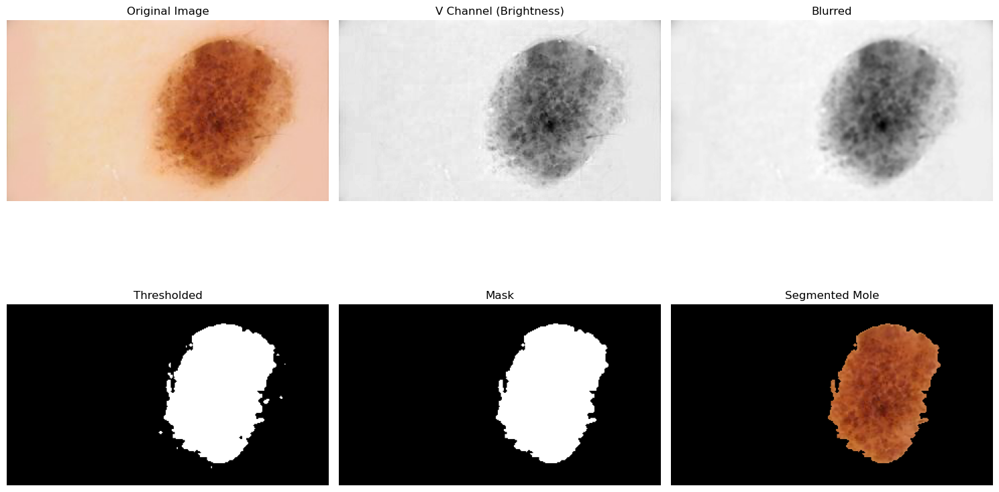

...

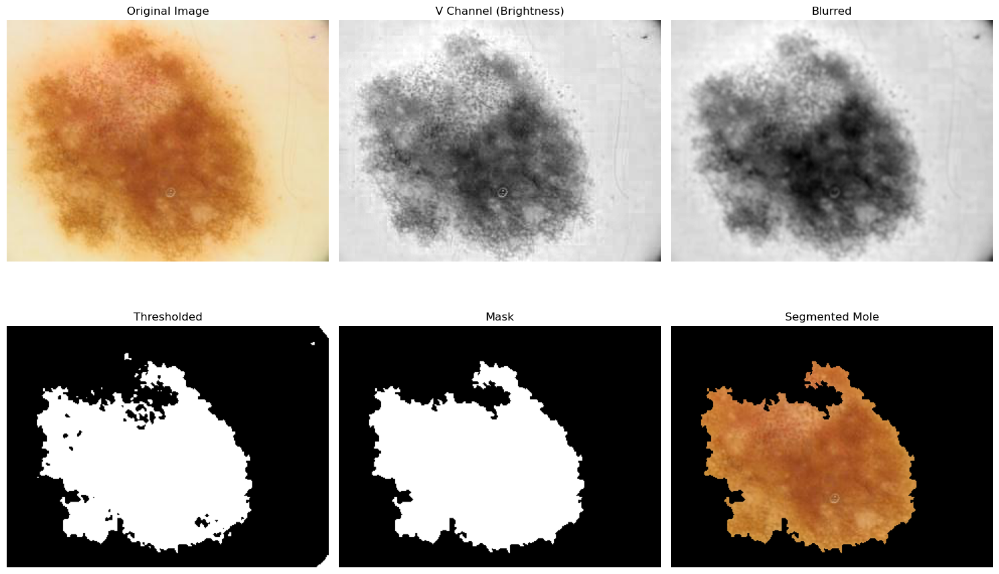

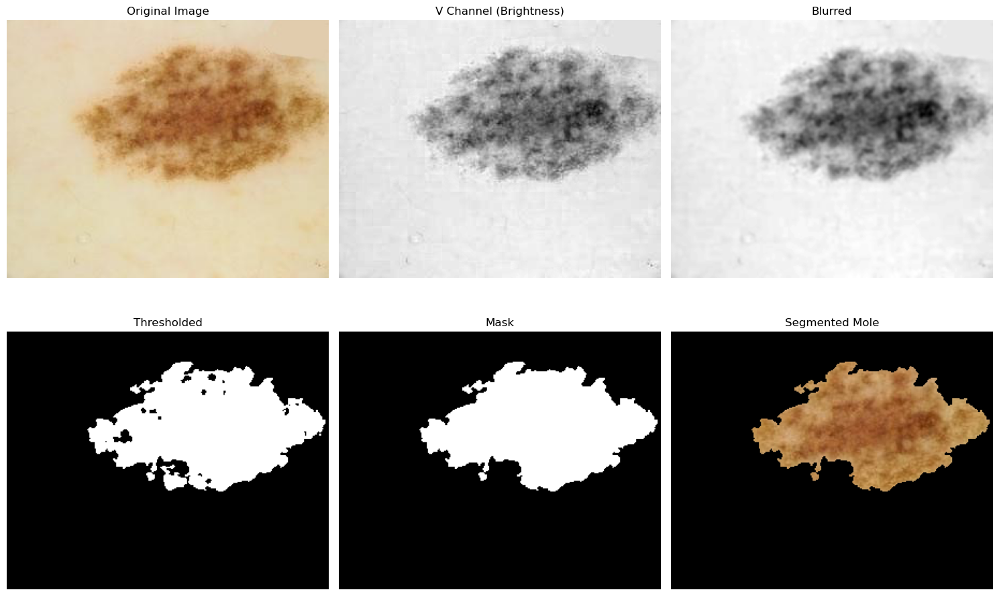

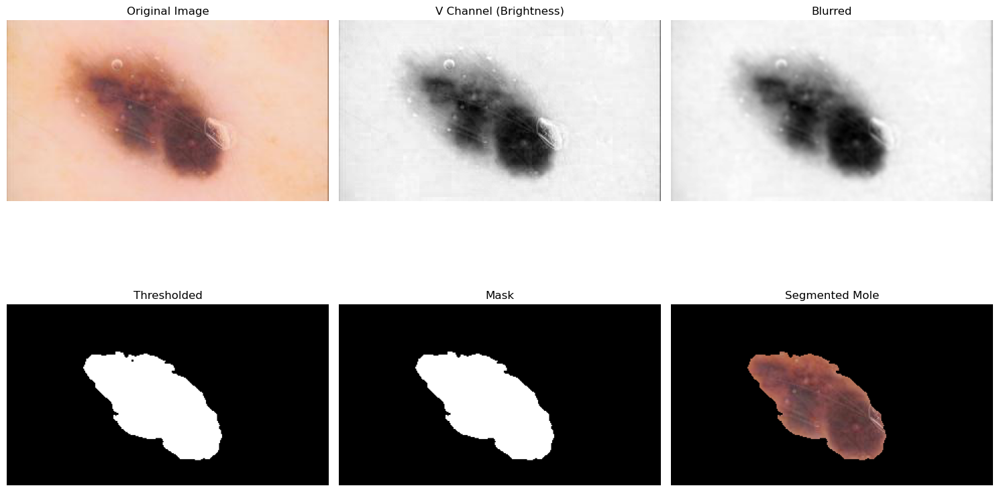

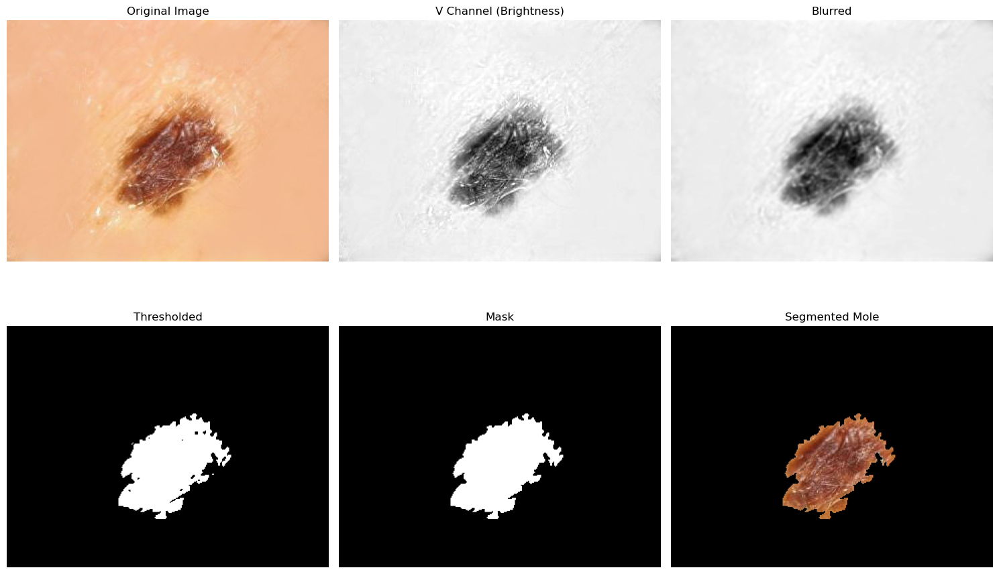

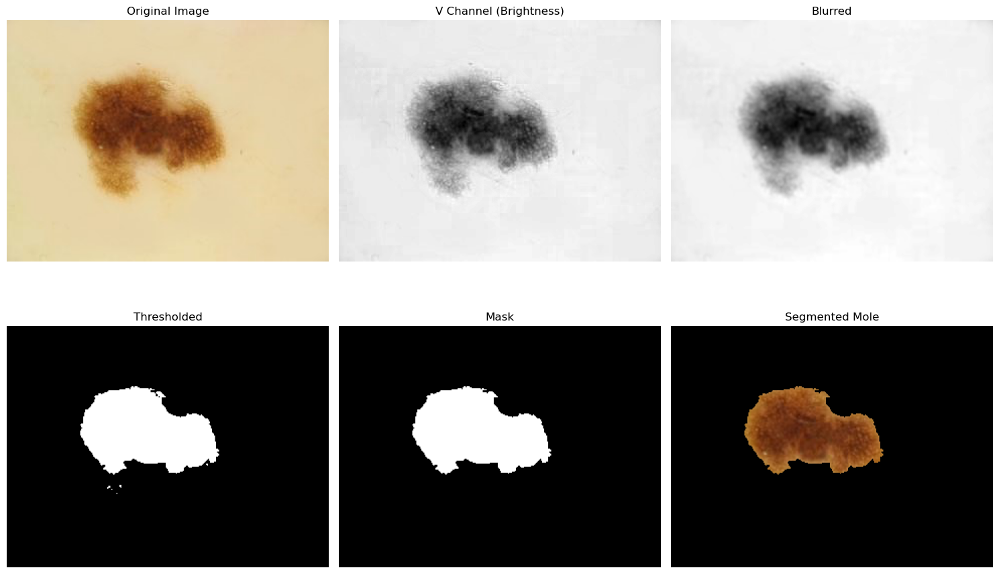

In [5]:

for filename in os.listdir(benign_folder):
    if filename.endswith('.jpg') or filename.endswith('.png'):
        image_path = os.path.join(benign_folder, filename)
        save_path = os.path.join(save_benign_folder, filename)
        visualize_segmentation_steps_hsv(image_path, save_path)

for filename in os.listdir(malignant_folder):
    if filename.endswith('.jpg') or filename.endswith('.png'):
        image_path = os.path.join(malignant_folder, filename)
        save_path = os.path.join(save_malignant_folder, filename)
        visualize_segmentation_steps_hsv(image_path, save_path)

In [6]:
# haudorff
import numpy as np
from scipy.ndimage import binary_fill_holes
from scipy.ndimage import binary_dilation

def hausdorff_dimension(image):
    """
    Compute the Hausdorff dimension of a binary image.
    
    Parameters:
    image : np.ndarray
        A binary image where non-zero pixels belong to the object.

    Returns:
    float
        The Hausdorff fractal dimension of the object.
    """
    # Pad the image with background pixels so that its dimensions are a power of 2
    max_dim = max(image.shape)
    new_dim_size = 2 ** np.ceil(np.log2(max_dim)).astype(int)
    pad_row = new_dim_size - image.shape[0]
    pad_col = new_dim_size - image.shape[1]
    padded_image = np.pad(image, ((0, pad_row), (0, pad_col)), mode='constant', constant_values=0)

    box_counts = []
    resolutions = []

    box_size = padded_image.shape[0]
    boxes_per_dim = 1

    while box_size >= 1:
        box_count = 0

        # Loop through each box
        for box_row in range(boxes_per_dim):
            for box_col in range(boxes_per_dim):
                min_row = box_row * box_size
                max_row = min((box_row + 1) * box_size, padded_image.shape[0])
                min_col = box_col * box_size
                max_col = min((box_col + 1) * box_size, padded_image.shape[1])

                # Check if there are any object pixels in the box
                if np.any(padded_image[min_row:max_row, min_col:max_col]):
                    box_count += 1

        # Store the counts and resolutions
        box_counts.append(box_count)
        resolutions.append(1 / box_size)

        # Update the parameters for the next iteration
        boxes_per_dim *= 2
        box_size //= 2

    # Fit a line to the log-log plot of box_counts vs. resolutions
    log_resolutions = np.log(resolutions)
    log_box_counts = np.log(box_counts)

    # Perform linear regression to find the slope
    D, _ = np.polyfit(log_resolutions, log_box_counts, 1)
    return D


In [7]:
benign_folder = r'C:\Users\Mia\Desktop\kpgm\Benign\HSV'
malignant_folder = r'C:\Users\Mia\Desktop\kpgm\Malignant\HSV'
from scipy.ndimage import binary_fill_holes